<a href="https://colab.research.google.com/github/Molten-Ice/3dGolfPoseDetection/blob/colab/dev-nbs/11-connecting-tensorboard.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!nvidia-smi

Tue Apr 25 23:40:38 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 525.85.12    Driver Version: 525.85.12    CUDA Version: 12.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  NVIDIA A100-SXM...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   34C    P0    41W / 400W |      0MiB / 40960MiB |      0%      Default |
|                               |                      |             Disabled |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [2]:
%load_ext tensorboard

In [3]:
from torch.utils.tensorboard import SummaryWriter

layout = {
    "ABCDE": {
        "losses" : ["Multiline", ["losses/loss_classifier", "losses/loss_box_reg", "losses/loss_objectness", "losses/loss_rpn_box_reg", "losses/loss_keypoint"]],
        "bbox_accuracy": ["Multiline", ["bbox_accuracy/train", "bbox_accuracy/test"]],
        "keypoint_accuracy": ["Multiline", ["keypoint_accuracy/train_grip", "keypoint_accuracy/test_grip", "keypoint_accuracy/train_head", "keypoint_accuracy/test_head"]],
    },
}

# default `log_dir` is "runs" - we'll be more specific here
writer = SummaryWriter('runs/3dGolfPose')
writer.add_custom_scalars(layout)

In [4]:
import torch
import torchvision
import torch.nn as nn
import albumentations as A # Library for augmentations
import torch.nn.functional as F
from torchvision import transforms
from torch.utils.data import Dataset, DataLoader
from torchvision.models.detection import keypointrcnn_resnet50_fpn, KeypointRCNN_ResNet50_FPN_Weights

import os
import cv2
import json
import time
import random
import argparse
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image, ImageOps


# repo_dir = "c:/Users/James/git/3dGolfPoseDetection/"
# repo_dir = "/home/fsuser/3dGolfPoseDetection/"
repo_dir = "/content/"
data_path = repo_dir + "downloaded-data/"

if not os.path.exists(data_path): 
    print("Creating folder: ", data_path)
    os.mkdir(data_path)

Creating folder:  /content/downloaded-data/


In [5]:
### Download data from kaggle on google colab) ###

import json
import zipfile
kaggle_apikey = {"username":"jamesdavey","key":"a8975caa44cfa08d6f2164f2d5977b6e"}

if not os.path.exists('/root/.kaggle'): os.mkdir('/root/.kaggle')
with open('/root/.kaggle/kaggle.json', 'w') as f:
    json.dump(kaggle_apikey, f)

! chmod 600 ~/.kaggle/kaggle.json

!kaggle config set -n path -v {data_path}

## Download and unzip data ##

! kaggle datasets download jamesdavey/labelled-golf-clubs
zip_path = data_path+"datasets/jamesdavey/labelled-golf-clubs/labelled-golf-clubs.zip"
with zipfile.ZipFile(zip_path,"r") as zip_ref:
    zip_ref.extractall(data_path)

- path is now set to: /content/downloaded-data/
 98% 659M/671M [00:05<00:00, 151MB/s]
100% 671M/671M [00:05<00:00, 134MB/s]


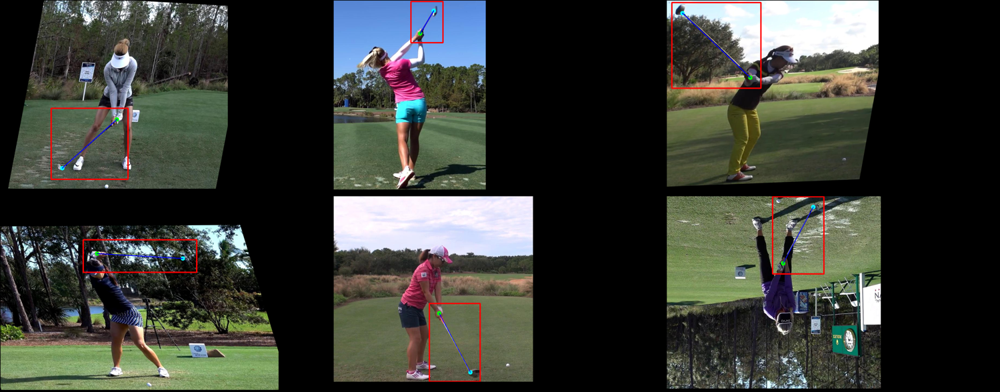

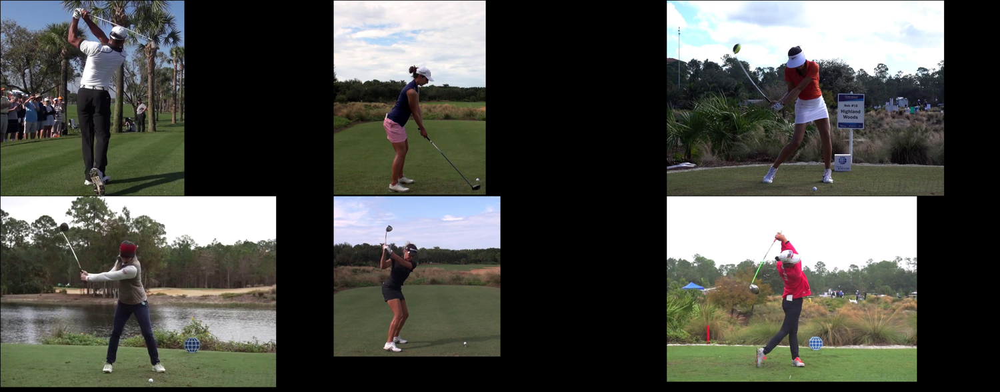

In [6]:
def label_img(img, grip, club, box_cords, line_width=4):
    
    return img

class GolfDataset(torch.utils.data.Dataset):
    def __init__(self, save_dir, filenames, annotate = False, padding = False, augment = False):
        self.save_dir = save_dir
        self.filenames = filenames
        self.annotate = annotate
        self.img_transforms = transforms.ToTensor()
        self.padding = padding
        self.augment = augment

        self.max_augmentation_attempts = 10
        self.albumentations_transform = A.Compose(
            [A.HorizontalFlip(p=0.5),
            A.VerticalFlip(p=0.5),
            A.Affine(p=0.5)],
            keypoint_params=A.KeypointParams(format='xy'))
        
    # A.OneOf([
    #                 A.HueSaturationValue(p=0.5), 
    #                 A.RGBShift(p=0.7)
    #             ], p=0.5),                          
    #         A.RandomBrightnessContrast(p=0.5),
    #         A.Rotate(p=1),
    #         A.ShiftScaleRotate(p=0.5)], 

    def __len__(self):
        return len(self.filenames)
    
    def __getitem__(self, idx):
        filename = self.filenames[idx]
        img = cv2.imread(self.save_dir+filename)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        cords = [int(x) for x in filename.split("_")[1].split("-")]
        grip, head = cords[:2], cords[2:]

        if self.augment:
            for i in range(self.max_augmentation_attempts): # 10 attempts to crop keypoints within, otherwise use original img
                transformed = self.albumentations_transform(image=img, keypoints=[grip, head])
                if len(transformed['keypoints']) == 2: # keypoint has not been cropped out
                    # print(f"Both keypoints found, after {i} tries")
                    img = transformed['image']
                    grip, head = transformed['keypoints']
                    break
            grip, head = [int(x) for x in grip], [int(x) for x in head]

        box_buffer = max(img.shape[:2])//20
        box_cords = [
            max(min(grip[0], head[0])-box_buffer, 1),
            max(min(grip[1], head[1])-box_buffer, 1), #top left cord
            min(max(grip[0], head[0])+box_buffer, img.shape[1]-1), # shape[0] is y
            min(max(grip[1], head[1])+box_buffer, img.shape[0]-1)] # bottom right cord

        if self.annotate:
            cv2.circle(img, grip, 8, (0,255,0), -1)
            cv2.circle(img, head, 8, (0,255,255), -1)
            cv2.line(img, head, grip, (0, 0, 255), 2)
            cv2.rectangle(img, box_cords[:2], box_cords[2:], (255, 0, 0), 4)

        if self.padding:
            max_height, max_width = 720, 1225
            height, width = img.shape[:2]
            img = cv2.copyMakeBorder(img, 0, max_height-height, 0, max_width-width, cv2.BORDER_CONSTANT)

        # During training, the model expects both the input tensors and targets (list of dictionary), containing:
        # boxes (FloatTensor[N, 4]): the ground-truth boxes in [x1, y1, x2, y2] format, with 0 <= x1 < x2 <= W and 0 <= y1 < y2 <= H.
        # labels (Int64Tensor[N]): the class label for each ground-truth box
        # keypoints (FloatTensor[N, K, 3]): the K keypoints location for each of the N instances, in the format [x, y, visibility], where visibility=0 means that the keypoint is not visible.
        target = {}
        target["boxes"] = torch.Tensor(box_cords).unsqueeze(dim=0).type(torch.FloatTensor)
        target["labels"] = torch.Tensor(torch.ones(1)).type(torch.int64)
        target["keypoints"] = torch.Tensor([grip + [1.], head + [1.]]).unsqueeze(dim=0).type(torch.FloatTensor)

        img = Image.fromarray(img)
        img = self.img_transforms(img)
        return img, target
    
def collate_fn(batch):
    return tuple(zip(*batch))

batch_size = 6

images_dir = data_path + "saved-labels/"
filenames = sorted(os.listdir(images_dir))[:50]

train_test_split = 0.8
split_index = int(len(filenames)*train_test_split)
train_filenames, test_filenames = filenames[:split_index], filenames[split_index:]

train_dataset = GolfDataset(images_dir, train_filenames, annotate = True, padding = True, augment = True)
train_dataloader = torch.utils.data.DataLoader(train_dataset, collate_fn=collate_fn, batch_size=batch_size, shuffle=False)

test_dataset = GolfDataset(images_dir, test_filenames, annotate = False, padding = True, augment = False)
test_dataloader = torch.utils.data.DataLoader(test_dataset, collate_fn=collate_fn, batch_size=batch_size, shuffle=False)

batch = next(iter(train_dataloader))
torch_grid = torchvision.utils.make_grid(torch.stack(batch[0],dim=0).cpu(), nrow = 3)
writer.add_image('Augmented images', torch_grid)
display_img = Image.fromarray((torch_grid.permute(1,2,0).numpy()*255).astype(np.uint8))
display(ImageOps.contain(display_img, (1500, 1500)))

batch = next(iter(test_dataloader))
torch_grid = torchvision.utils.make_grid(torch.stack(batch[0],dim=0).cpu(), nrow = 3)
writer.add_image('Test images', torch_grid)
display_img = Image.fromarray((torch_grid.permute(1,2,0).numpy()*255).astype(np.uint8))
display(ImageOps.contain(display_img, (1500, 1500)))

In [7]:
def evaluate_model(model, dataloader):
    box_diffs = []
    keypoint_diffs = []
    total_elements = 0

    t_start = time.time()
    model.eval()
    with torch.no_grad():
        for batch_idx, batch in enumerate(dataloader):
            images = [img.to(device) for img in batch[0]]
            targets = [{key: d[key].to(device) for key in d.keys()} for d in batch[1]]
            preds = model(images)

            total_elements+=len(preds)
            for idx in range(len(preds)):
                predicted_boxes = preds[idx]['boxes']
                predicted_clubs = preds[idx]['keypoints']
                if len(predicted_boxes) > 0:
                    real_box = targets[idx]['boxes'][0]
                    box_diffs.append(torch.abs(predicted_boxes[0] - real_box))

                if len(predicted_clubs) > 0:
                    real_keypoints = targets[idx]['keypoints'][0]
                    keypoint_diffs.append(torch.abs(predicted_clubs[0] - real_keypoints)[:,:2])
    model.train()

    if len(box_diffs) == 0:
        average_box_diff = ['inf', 'inf', 'inf', 'inf']
        boxes_predicted = 0
    else:
        stacked_boxes = torch.stack(box_diffs,dim=0).cpu().numpy()
        average_box_diff = np.mean(stacked_boxes, axis=0)
        boxes_predicted = stacked_boxes.shape[0]

    if len(keypoint_diffs) == 0:
        average_club_diff = ['inf', 'inf', 'inf']
        keypoints_predicted = 0
    else:
        stacked_keypoints = torch.stack(keypoint_diffs,dim=0).cpu().numpy() #[[(x_grip, y_grip), (x_club, y_club)],...]
        average_keypoint_diff = np.mean(stacked_keypoints, axis=0)
        keypoints_predicted = stacked_keypoints.shape[0]

    return average_box_diff, average_keypoint_diff, total_elements, boxes_predicted, keypoints_predicted, time.time()-t_start

In [8]:
device = 'cuda:0' if torch.cuda.is_available() else 'cpu'

model = keypointrcnn_resnet50_fpn(weights=KeypointRCNN_ResNet50_FPN_Weights.DEFAULT)
model.eval()
out = nn.ConvTranspose2d(512, 2, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
model.roi_heads.keypoint_predictor.kps_score_lowres = out
model = model.to(device)

#freeze parameters in backbone
for param in model.backbone.parameters():
    param.requires_grad = False

Downloading: "https://download.pytorch.org/models/keypointrcnn_resnet50_fpn_coco-fc266e95.pth" to /root/.cache/torch/hub/checkpoints/keypointrcnn_resnet50_fpn_coco-fc266e95.pth
100%|██████████| 226M/226M [00:04<00:00, 47.4MB/s]


In [9]:
batch_size = 8

images_dir = data_path + "saved-labels/"
filenames = sorted(os.listdir(images_dir))[:100]

train_test_split = 0.8
split_index = int(len(filenames)*train_test_split)
train_filenames, test_filenames = filenames[:split_index], filenames[split_index:]

#without augmentations (only for evaluation)
# train_dataset_clean = GolfDataset(images_dir, train_filenames, annotate = False, padding = False, augment = False)
# train_dataloader_clean = torch.utils.data.DataLoader(train_dataset_clean, collate_fn=collate_fn, batch_size=batch_size, shuffle=False)

#with augmentations
train_dataset = GolfDataset(images_dir, train_filenames, annotate = False, padding = False, augment = False)
train_dataloader = torch.utils.data.DataLoader(train_dataset, collate_fn=collate_fn, batch_size=batch_size, shuffle=False)

test_dataset = GolfDataset(images_dir, test_filenames, annotate = False, padding = False, augment = False)
test_dataloader = torch.utils.data.DataLoader(test_dataset, collate_fn=collate_fn, batch_size=batch_size, shuffle=False)

print(f"Dataset lengths | train {len(train_dataset)}, test {len(test_dataset)}")
print(f"Dataloader #batches | train {len(train_dataloader)}, test {len(test_dataloader)}, batches of size {batch_size}")

Dataset lengths | train 80, test 20
Dataloader #batches | train 10, test 3, batches of size 8


In [10]:
# Use data Augmentation!!!
# Train Evaluation | bbox: 142.68, grip: 73.04, head: 186.31 | bbox: [800/800], keypoints: [800/800], Time taken: 41.49s
# Test Evaluation | bbox: 143.12, grip: 78.81, head: 188.26 | bbox: [200/200], keypoints: [200/200], Time taken: 10.10s
# ↓↓↓
# Train Evaluation | bbox: 8.06, grip: 1.66, head: 3.97 | bbox: [800/800], keypoints: [800/800], Time taken: 39.32s
# Test Evaluation | bbox: 20.59, grip: 6.08, head: 26.63 | bbox: [200/200], keypoints: [200/200], Time taken: 10.04s

#With data augmentation:
#after 9 epochs, lr = 3e-4
# Train Evaluation | bbox: 43.11, grip: 19.06, head: 56.58 | bbox: [800/800], keypoints: [800/800], Time taken: 47.90s
# Test Evaluation | bbox: 38.77, grip: 13.01, head: 55.12 | bbox: [200/200], keypoints: [200/200], Time taken: 9.40s
# Train_clean Evaluation | bbox: 37.87, grip: 13.86, head: 47.26 | bbox: [800/800], keypoints: [800/800], Time taken: 37.20s

In [11]:
### Hyperparameters ###

epochs = 9
lr = 3e-3
eval_interval = 2

params = [p for p in model.parameters() if p.requires_grad]
optimizer = torch.optim.Adam(params, lr=lr)
lr_scheduler_epochs = torch.optim.lr_scheduler.CosineAnnealingLR(optimizer, epochs)


metrics = {"Train_boxes": [],
           "Train_keypoints": [],
           "Test_boxes": [],
           "Test_keypoints": [],
           "Train_clean_boxes": [],
           "Train_clean_keypoints": []}

# Starting evaluation
# for split, dataloader in zip(["train", "test","train_clean"], [train_dataloader, test_dataloader, train_dataloader_clean]):
for split, dataloader in zip(["train", "test"], [train_dataloader, test_dataloader]):
    average_box_diff, average_keypoint_diff, total_elements, boxes_predicted, clubs_predicted, time_taken = evaluate_model(model, dataloader)
    print(f"{split} Evaluation | bbox: {average_box_diff.mean():.2f}, grip: {average_keypoint_diff[0].mean():.2f}, head: {average_keypoint_diff[1].mean():.2f} | bbox: [{boxes_predicted}/{total_elements}], keypoints: [{clubs_predicted}/{total_elements}], Time taken: {time_taken:.2f}s")
    writer.add_scalar(f"bbox_accuracy/{split}", average_box_diff.mean(), 0)
    writer.add_scalar(f"keypoint_accuracy/{split}_grip", average_keypoint_diff[0].mean(), 0)
    writer.add_scalar(f"keypoint_accuracy/{split}_head", average_keypoint_diff[1].mean(), 0)

### Training loop ###
losses = []
lrs = []

training_iteration = 0
t_start = time.time()
model.train()
for epoch in range(epochs):
    print(f"--------- EPOCH {epoch} ---------")
    if epoch == 0: # learning rate warmup
        warmup_factor = 1.0 / 1000
        warmup_iters = min(1000, len(train_dataloader) - 1)
        lr_scheduler_warmup = torch.optim.lr_scheduler.LinearLR(optimizer, start_factor=warmup_factor, total_iters=warmup_iters)

    for batch_idx, batch in enumerate(train_dataloader):
        images = [img.to(device) for img in batch[0]]
        targets = [{key: d[key].to(device) for key in d.keys()} for d in batch[1]]

        losses_dict = model(images, targets)
        total_loss = sum([losses_dict[key] for key in losses_dict.keys()])
        optimizer.zero_grad()
        total_loss.backward()
        optimizer.step()

        if epoch == 0:
            lr_scheduler_warmup.step()
        lrs.append(optimizer.param_groups[0]['lr'])

        for key in losses_dict.keys():
            writer.add_scalar(f"losses/{key}", losses_dict[key].item(), training_iteration)
        training_iteration+=1

        losses.append([losses_dict[key].item() for key in losses_dict.keys()])

        if batch_idx % (len(train_dataloader)//2) == 0:
            print(f"Epoch [{epoch+1}/{epochs}], batch [{batch_idx+1}/{len(train_dataloader)}] | Total loss: {total_loss.item():.2f}, Time: {time.time()-t_start:.2f}s | {''.join([f'{key}: {losses_dict[key].item():.4f}, ' for key in losses_dict.keys()])}")

    lr_scheduler_epochs.step()

    if epoch % eval_interval == 0:   
        # for split, dataloader in zip(["train", "test","train_clean"], [train_dataloader, test_dataloader, train_dataloader_clean]):
        for split, dataloader in zip(["train", "test"], [train_dataloader, test_dataloader]):
            average_box_diff, average_keypoint_diff, total_elements, boxes_predicted, clubs_predicted, time_taken = evaluate_model(model, dataloader)
            print(f"{split} Evaluation | bbox: {average_box_diff.mean():.2f}, grip: {average_keypoint_diff[0].mean():.2f}, head: {average_keypoint_diff[1].mean():.2f} | bbox: [{boxes_predicted}/{total_elements}], keypoints: [{clubs_predicted}/{total_elements}], Time taken: {time_taken:.2f}s")
            writer.add_scalar(f"bbox_accuracy/{split}", average_box_diff.mean(), epoch+1)
            writer.add_scalar(f"keypoint_accuracy/{split}_grip", average_keypoint_diff[0].mean(), epoch+1)
            writer.add_scalar(f"keypoint_accuracy/{split}_head", average_keypoint_diff[1].mean(), epoch+1)

print(f"Total time: {time.time()-t_start:.2f}s")
# writer.close()


train Evaluation | bbox: 138.44, grip: 100.58, head: 170.86 | bbox: [80/80], keypoints: [80/80], Time taken: 10.85s
test Evaluation | bbox: 134.08, grip: 89.40, head: 204.53 | bbox: [20/20], keypoints: [20/20], Time taken: 0.87s
--------- EPOCH 0 ---------
Epoch [1/9], batch [1/10] | Total loss: 10.69, Time: 1.29s | loss_classifier: 0.2398, loss_box_reg: 0.0882, loss_keypoint: 10.2566, loss_objectness: 0.1005, loss_rpn_box_reg: 0.0037, 
Epoch [1/9], batch [6/10] | Total loss: 7.15, Time: 3.23s | loss_classifier: 0.1284, loss_box_reg: 0.1650, loss_keypoint: 6.8191, loss_objectness: 0.0314, loss_rpn_box_reg: 0.0093, 
train Evaluation | bbox: 112.12, grip: 72.21, head: 182.07 | bbox: [79/80], keypoints: [79/80], Time taken: 3.44s
test Evaluation | bbox: 110.96, grip: 46.53, head: 188.08 | bbox: [19/20], keypoints: [19/20], Time taken: 0.80s
--------- EPOCH 1 ---------
Epoch [2/9], batch [1/10] | Total loss: 7.86, Time: 9.45s | loss_classifier: 0.2216, loss_box_reg: 0.1303, loss_keypoint: 

In [12]:
%tensorboard --logdir runs

<IPython.core.display.Javascript object>

In [13]:
!tensorboard dev upload --logdir ./runs \
  --name "Complete test" \
  --description "Testing tensorboard" \
  --one_shot

2023-04-25 23:43:41.711037: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT

***** TensorBoard Uploader *****

This will upload your TensorBoard logs to https://tensorboard.dev/ from
the following directory:

./runs

This TensorBoard will be visible to everyone. Do not upload sensitive
data.

Your use of this service is subject to Google's Terms of Service
<https://policies.google.com/terms> and Privacy Policy
<https://policies.google.com/privacy>, and TensorBoard.dev's Terms of Service
<https://tensorboard.dev/policy/terms/>.

This notice will not be shown again while you are logged into the uploader.
To log out, run `tensorboard dev auth revoke`.

Continue? (yes/NO) yes

To sign in with the TensorBoard uploader:

1. On your computer or phone, visit:

   https://www.google.com/device

2. Sign in with your Google account, then enter:

   KTSJ-GVSF



New experiment created. View your TensorBoard at: https://tensorboard.dev/experiment/L9N4

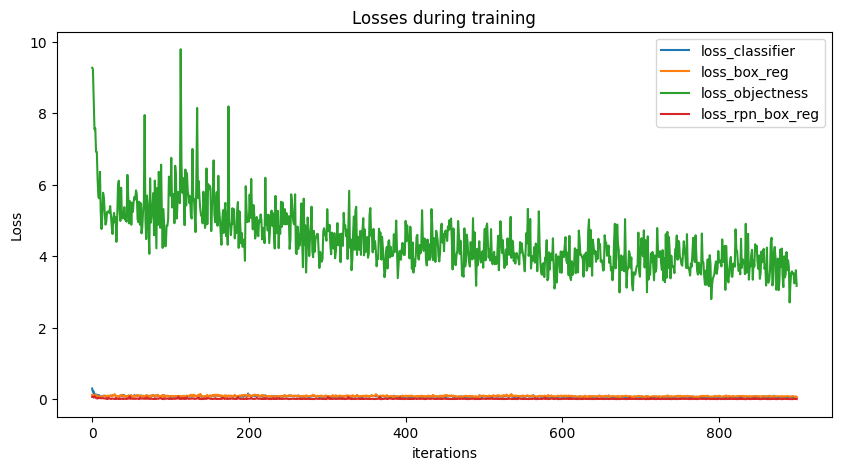

In [ ]:
plt.figure(figsize=(10,5))
plt.title("Losses during training")
losses = np.array(losses)
keys_to_train = ['loss_classifier', 'loss_box_reg', 'loss_objectness', 'loss_rpn_box_reg', 'loss_keypoint']
for i, key in enumerate(keys_to_train[:4]):
    plt.plot(losses[:,i],label=key)

plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

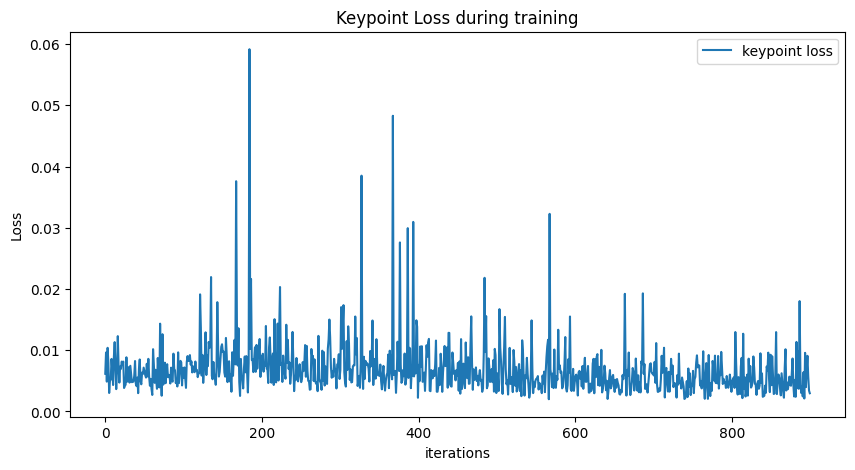

In [ ]:
plt.figure(figsize=(10,5))
plt.title("Keypoint Loss during training")
plt.plot(losses[:,4],label="keypoint loss")

plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

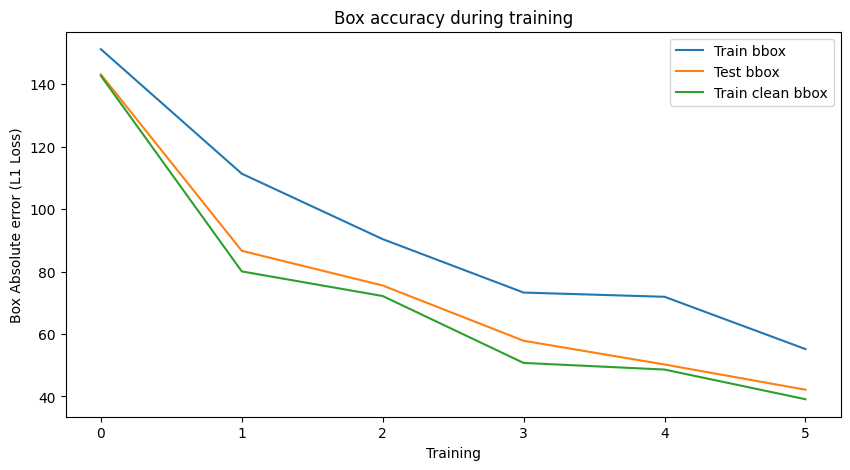

In [ ]:
plt.figure(figsize=(10,5))
plt.title("Box accuracy during training")

plt.plot(np.array(metrics['Train_boxes']).mean(axis=1), label = "Train bbox")
plt.plot(np.array(metrics['Test_boxes']).mean(axis=1), label = "Test bbox")
plt.plot(np.array(metrics['Train_clean_boxes']).mean(axis=1), label = "Train clean bbox")

plt.xlabel("Training")
plt.ylabel("Box Absolute error (L1 Loss)")
plt.legend()
plt.show()

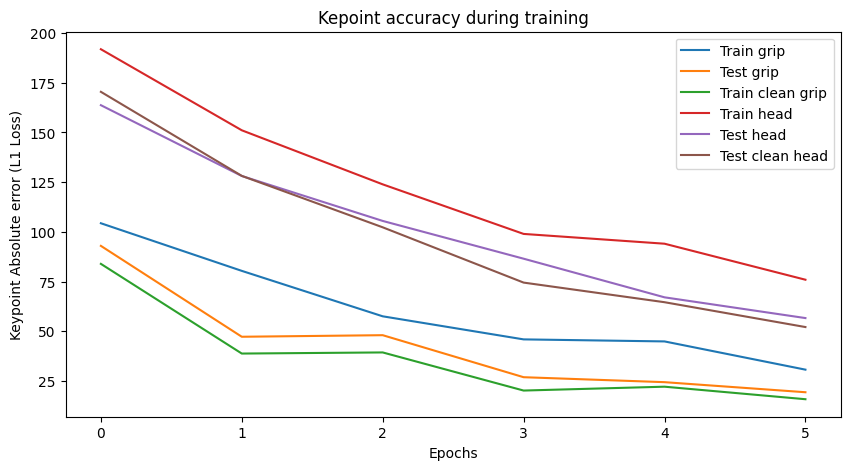

In [ ]:
plt.figure(figsize=(10,5))
plt.title("Kepoint accuracy during training")

plt.plot(np.array(metrics['Train_keypoints']).mean(axis=2)[:, 0], label = "Train grip")
plt.plot(np.array(metrics['Test_keypoints']).mean(axis=2)[:, 0], label = "Test grip")
plt.plot(np.array(metrics['Train_clean_keypoints']).mean(axis=2)[:, 0], label = "Train clean grip")

plt.plot(np.array(metrics['Train_keypoints']).mean(axis=2)[:, 1], label = "Train head")
plt.plot(np.array(metrics['Test_keypoints']).mean(axis=2)[:, 1], label = "Test head")
plt.plot(np.array(metrics['Train_clean_keypoints']).mean(axis=2)[:, 1], label = "Test clean head")

plt.xlabel("Epochs")
plt.ylabel("Keypoint Absolute error (L1 Loss)")
plt.legend()
plt.show()


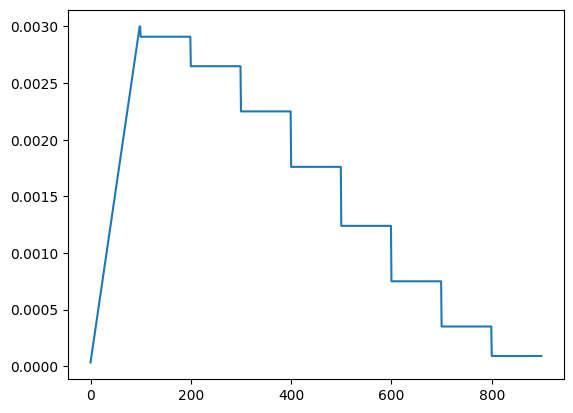

In [ ]:
plt.plot(lrs)

In [ ]:
def label_pred(tensor_img, box, keypoints):
    
    img = (tensor_img*255).type(torch.uint8).permute(1,2,0).cpu().numpy()
    labelled = img[: , : , ::-1].copy().astype(np.uint8)

    box_cords = [int(x) for x in box]
    cv2.rectangle(labelled, box_cords[:2], box_cords[2:], (124,252,0), 3)

    grip, club = keypoints
    grip = [int(x) for x in grip[:2]]
    club = [int(x) for x in club[:2]]
    cv2.circle(labelled, grip, 5, (200, 0, 0), -1)
    cv2.circle(labelled, club, 5, (200, 0, 0), -1)
    cv2.line(labelled, club[:2], grip[:2], (0, 128, 255), 2)

    max_height, max_width = 720, 1225
    height, width = labelled.shape[:2]
    labelled = cv2.copyMakeBorder(labelled, 0, max_height-height, 0, max_width-width, cv2.BORDER_CONSTANT)

    labelled = labelled[:,:,::-1]
    return labelled.copy()

In [ ]:
def generate_predictions(model, dataloader, imgs_to_generate = 16):

    img_transforms = transforms.ToTensor()
    labelled_images = []

    model.eval()
    with torch.no_grad():
        for batch_idx, batch in enumerate(dataloader):
            if len(labelled_images) >= imgs_to_generate:
                break

            images = [img.to(device) for img in batch[0]]
            targets = batch[1] # [{key: d[key].to(device) for key in d.keys()} for d in batch[1]]
            preds = model(images)

            for idx in range(len(preds)):
                predicted_boxes = preds[idx]['boxes']
                predicted_clubs = preds[idx]['keypoints']

                if not (len(predicted_boxes > 0) and len(predicted_clubs > 0)):
                    print(f"Skipping {idx} box/club not predicted")
                    continue

                predicted_box = predicted_boxes[0].cpu()
                predicted_club = predicted_clubs[0].cpu()
                tensor_img = images[idx]

                labelled_img = Image.fromarray(label_pred(tensor_img, predicted_box, predicted_club))
                labelled_images.append(img_transforms(labelled_img))
    
                if len(labelled_images) >= imgs_to_generate:
                    break
    return labelled_images

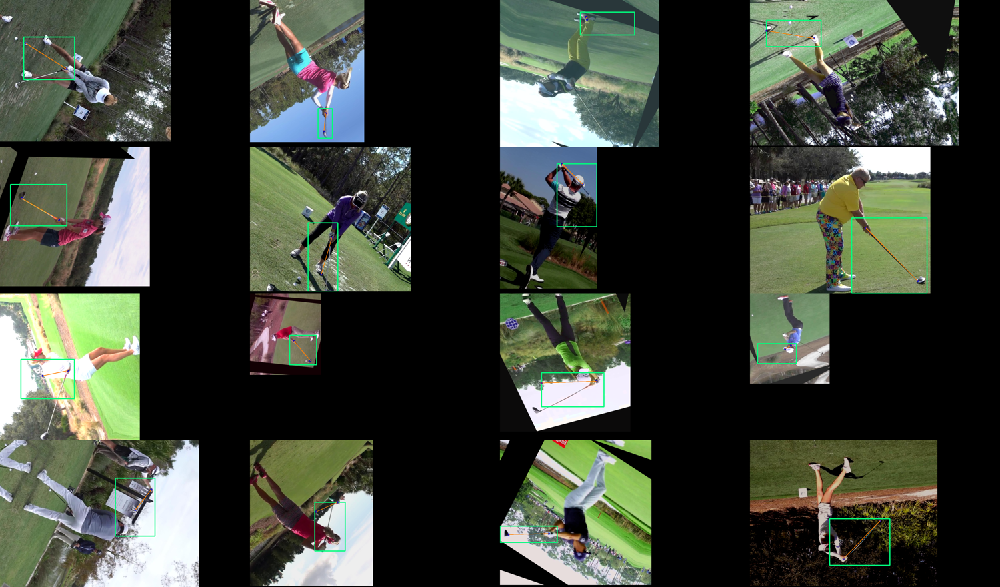

In [ ]:
labelled_images = generate_predictions(model, train_dataloader)
display_img = Image.fromarray((torchvision.utils.make_grid(torch.stack(labelled_images, dim=0), padding=0, nrow = 4, normalize=False).permute(1,2,0).numpy()*255).astype(np.uint8))
display(ImageOps.contain(display_img, (1500, 1500)))

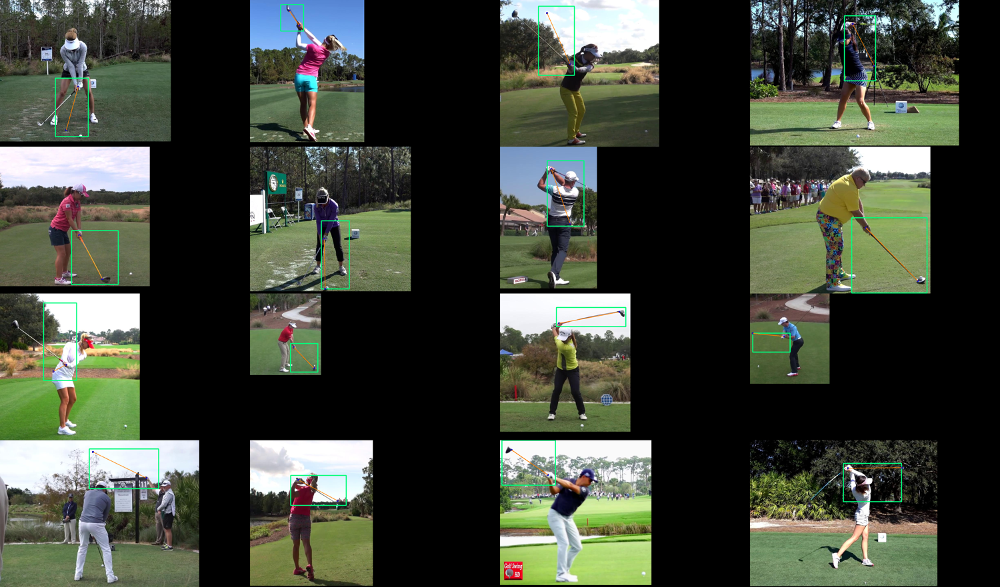

In [ ]:
labelled_images = generate_predictions(model, train_dataloader_clean)
display_img = Image.fromarray((torchvision.utils.make_grid(torch.stack(labelled_images, dim=0), padding=0, nrow = 4, normalize=False).permute(1,2,0).numpy()*255).astype(np.uint8))
display(ImageOps.contain(display_img, (1500, 1500)))

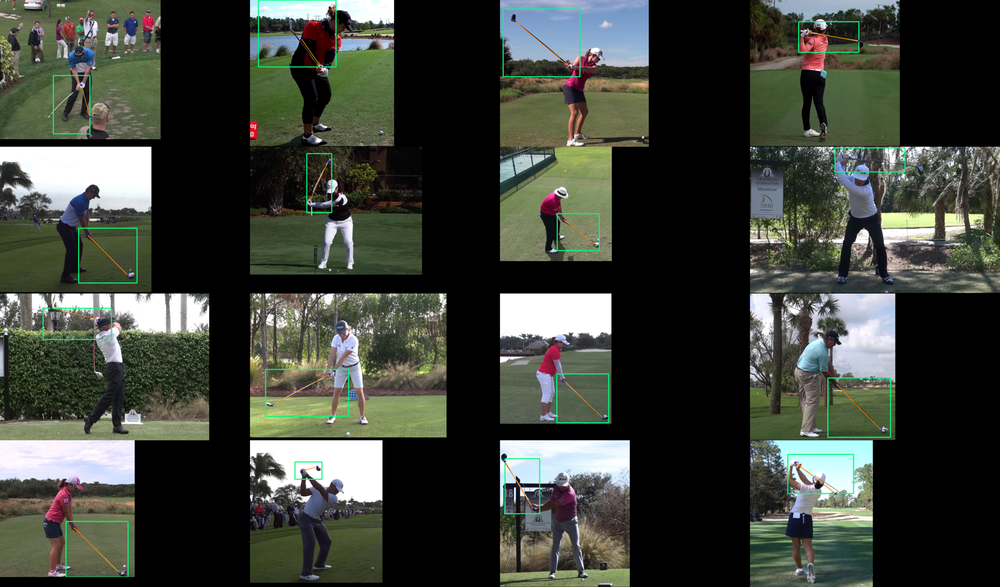

In [ ]:
labelled_images = generate_predictions(model, test_dataloader)
display_img = Image.fromarray((torchvision.utils.make_grid(torch.stack(labelled_images, dim=0), padding=0, nrow = 4, normalize=False).permute(1,2,0).numpy()*255).astype(np.uint8))
display(ImageOps.contain(display_img, (1500, 1500)))

In [ ]:
# Get worse performing train/test examples, to try and spot what they could be missing